In [1]:
import numpy as np
from sklearn.metrics import  mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import os
from matplotlib.colors import Normalize
from scipy.stats import pearsonr
    # Pearson correlation
# Using scipy's linregress
def calculate_slope(true, pred):
    from scipy.stats import linregress
    result = linregress(true, pred)
    return result.slope

def calculate_bias(y_true, y_pred):
    return np.mean(y_pred - y_true)

def nmae_quantile(y_true, y_pred, is_quantile=False, lower_quantile=0.25, upper_quantile=0.75):
    """
    Calculate the Normalized Mean Absolute Error (NMAE) normalized by the quantile range.
    
    Parameters:
        y_true (array-like): Actual values.
        y_pred (array-like): Predicted values.
        lower_quantile (float): Lower quantile (default is 0.25 for Q1).
        upper_quantile (float): Upper quantile (default is 0.75 for Q3).
        
    Returns:
        float: NMAE normalized by the quantile range.
    """
    # Convert inputs to numpy arrays
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    
    # Compute MAE
    mae = mean_absolute_error(y_true, y_pred)
    
    # Compute quantile range
    if not is_quantile:
        return mae
    
    q_low = np.quantile(y_true, lower_quantile)
    q_high = np.quantile(y_true, upper_quantile)
    quantile_range = q_high - q_low
    
    # Avoid division by zero
    if quantile_range == 0:
        raise ValueError("Quantile range is zero. Check your data distribution.")
    
    # Compute NMAE
    nmae = mae / quantile_range
    return nmae
    

def nrmse_quantile(y_true, y_pred, is_quantile=False, lower_quantile=0.25, upper_quantile=0.75):
    """
    Calculate the Normalized Root Mean Square Error (NRMSE) normalized by the quantile range.
    
    Parameters:
        y_true (array-like): Actual values.
        y_pred (array-like): Predicted values.
        lower_quantile (float): Lower quantile (default is 0.25 for Q1).
        upper_quantile (float): Upper quantile (default is 0.75 for Q3).
        
    Returns:
        float: NRMSE normalized by the quantile range.
    """
    # Convert inputs to numpy arrays
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)
    
    # Compute RMSE
    rmse = mean_squared_error(y_true, y_pred, squared=False)
    
    if not is_quantile:
        return rmse
    
    # Compute quantile range
    q_low = np.quantile(y_true, lower_quantile)
    q_high = np.quantile(y_true, upper_quantile)
    quantile_range = q_high - q_low
    
    # Avoid division by zero
    if quantile_range == 0:
        raise ValueError("Quantile range is zero. Check your data distribution.")
    
    # Compute NRMSE
    nrmse = rmse / quantile_range
    return nrmse

def pearson_r(y_true, y_pred):
    r, p_value = pearsonr(y_true, y_pred)
    return r.round(4)

def plothexbin(data, true, pred, label=None, scaleaxis=True, allmetrics=True, norm ='range',  output_dir=None, suffix=None):
    # Calculate metrics
    x = data[true]
    y = data[pred]
    print(f'x: {x.shape}, y: {y.shape}')
    print(f'x: {x}, y: {y}')
    if x.shape == (0,) or y.shape == (0,):
        print(f'x: {x.shape}, y: {y.shape}')
        return
    r2 = r2_score(x, y)
    if allmetrics:
        # Normalize x and y between 0 and 1
        if norm == 'quantile':
            nmae = nmae_quantile(x, y, is_quantile=True)
            nrmse = nrmse_quantile(x, y, is_quantile=True)
        elif norm == 'mean':
            nmae = mean_absolute_error(x, y) / x.mean()
            nrmse = mean_squared_error(x, y, squared=False) / x.mean()
        elif norm == 'range':
            nmae = mean_absolute_error(x, y) / (x.max() - x.min())
            nrmse = mean_squared_error(x, y, squared=False) / (x.max() - x.min())
        
        bias = calculate_bias(x, y)
        slope = calculate_slope(x, y)
        pearson_r_value = pearson_r(x, y)
        
    # Create hexbin plot
    plt.figure(figsize=(6, 6))
    ax = plt.gca()
    ax.set_aspect('equal', adjustable='box')  # Equal aspect ratio to avoid hexagon distortion

    # Set labels
    ax.set_xlabel(f'Observed {label}', fontsize=20, fontweight='bold')
    ax.set_ylabel(f'Predicted {label}', fontsize=20, fontweight='bold')

    # Determine axis limits and draw x=y line
    if scaleaxis:
        maxval = max(x.max(), y.max())
        minval = min(x.min(), y.min())
        ax.set_xlim(minval, maxval)
        ax.set_ylim(minval, maxval)
        ax.plot([minval, maxval], [minval, maxval], color='red', lw=2)
        extent = [minval, maxval, minval, maxval]

    # Hexbin plot with normalized density
    hb = ax.hexbin(x, y, gridsize=60, cmap='plasma', mincnt=1, extent=extent, 
                norm=Normalize(vmin=0, vmax=1))

    # Normalize counts manually (normalized density)
    counts = hb.get_array()
    norm_counts = counts / counts.max()  # Normalize to range [0, 1]
    hb.set_array(norm_counts)

    # Add R², MAE, and nRMSE as text on the plot
    if allmetrics:
        ax.text(0.05, 0.95, f'R²: {r2:.2f}\nnMAE: {nmae:.2f}\nnRMSE: {nrmse:.2f}\nbias: {bias:.2f}\nslope: {slope:.2f}\npearson r: {pearson_r_value:.2f}',
                transform=ax.transAxes, fontsize=14, verticalalignment='top',
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'))
    else:
        ax.text(0.05, 0.95, f'R²: {r2:.2f}',
                transform=ax.transAxes, fontsize=14, verticalalignment='top',
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'))

    print(f'{label} R²: {r2:.2f}')
    if allmetrics:
        print(f'{label} nMAE: {nmae:.2f}')
        print(f'{label} nRMSE: {nrmse:.2f}')

    # Ensure layout is tight
    plt.tight_layout(pad=0.5)

    # Save the plot
    path = f"{label}.png"
    if output_dir is not None:
        path = os.path.join(output_dir, path)
    if suffix is not None:
        path = path.replace('.png', f'_{suffix}.png')
    plt.savefig(path, bbox_inches='tight', pad_inches=0.1)
    plt.close()

## Run inference on the training data using the checkpoint with the best performance on the reference dataset, and update the output paths for both normalized and unnormalized outputs.

In [ ]:
norm_val = '</path/to/val.csv>'
val = '</path/to/normalized_val.csv>'

In [22]:
import pandas as pd
norm_val = pd.read_csv(norm_val)
val = pd.read_csv(val)
print(norm_val.shape, val.shape)

(284336, 12) (284336, 12)


In [23]:
uncertainity_cols = norm_val.columns[::-1][:4]
uncertainity_cols

Index(['Leaf_N_median_uncertainty', 'SLA_median_uncertainty',
       'LeafArea_median_uncertainty', 'Height_median_uncertainty'],
      dtype='object')

In [24]:
val = pd.concat([val, norm_val[uncertainity_cols]], axis=1)
val

,Height_median_true,LeafArea_median_true,SLA_median_true,Leaf_N_median_true,Height_median_pred,LeafArea_median_pred,SLA_median_pred,Leaf_N_median_pred,Height_median_uncertainty,LeafArea_median_uncertainty,SLA_median_uncertainty,Leaf_N_median_uncertainty,Leaf_N_median_uncertainty,SLA_median_uncertainty,LeafArea_median_uncertainty,Height_median_uncertainty
0,13.987935,12.463890,11.578178,24.527560,10.776169,15.471607,16.763678,27.109470,NaN,NaN,NaN,NaN,-1.585836,-2.082406,-2.341355,-1.713484
1,13.987935,12.463890,11.578178,24.527560,19.806814,36.857777,13.019522,20.465773,NaN,NaN,NaN,NaN,-1.674644,-2.119239,-1.906090,-1.473963
2,13.987935,12.463890,11.578178,24.527560,15.616657,32.271458,14.150058,23.537542,NaN,NaN,NaN,NaN,-1.792509,-2.186719,-1.874176,-1.664432
3,13.987935,12.463890,11.578178,24.527560,10.776169,15.471607,16.763678,27.109470,NaN,NaN,NaN,NaN,-1.585836,-2.082406,-2.341355,-1.713484
4,29.822601,0.537402,7.022791,12.863557,11.991335,8.753674,9.499618,16.504852,NaN,NaN,NaN,NaN,-2.141615,-2.521720,-3.144988,-1.379227
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284331,20.454890,45.830997,13.062060,23.440187,9.380766,33.747417,14.567678,23.217556,NaN,NaN,NaN,NaN,-1.769160,-2.014449,-2.327637,-1.996895
284332,20.454890,45.830997,13.062060,23.440187,14.734003,47.559273,13.127729,21.790491,NaN,NaN,NaN,NaN,-1.683870,-2.031440,-1.730755,-1.422946
284333,20.454890,45.830997,13.062060,23.440187,16.616661,22.549948,13.077711,21.298270,NaN,NaN,NaN,NaN,-1.932134,-2.354497,-2.540022,-1.724608
284334,10.619714,23.997944,16.120485,36.542060,12.624937,50.885815,14.397921,22.154661,NaN,NaN,NaN,NaN,-1.803495,-2.212242,-1.702169,-1.664809


In [25]:
#drop cols where all values are nana
val = val.dropna(axis=1, how='all')
val

,Height_median_true,LeafArea_median_true,SLA_median_true,Leaf_N_median_true,Height_median_pred,LeafArea_median_pred,SLA_median_pred,Leaf_N_median_pred,Leaf_N_median_uncertainty,SLA_median_uncertainty,LeafArea_median_uncertainty,Height_median_uncertainty
0,13.987935,12.463890,11.578178,24.527560,10.776169,15.471607,16.763678,27.109470,-1.585836,-2.082406,-2.341355,-1.713484
1,13.987935,12.463890,11.578178,24.527560,19.806814,36.857777,13.019522,20.465773,-1.674644,-2.119239,-1.906090,-1.473963
2,13.987935,12.463890,11.578178,24.527560,15.616657,32.271458,14.150058,23.537542,-1.792509,-2.186719,-1.874176,-1.664432
3,13.987935,12.463890,11.578178,24.527560,10.776169,15.471607,16.763678,27.109470,-1.585836,-2.082406,-2.341355,-1.713484
4,29.822601,0.537402,7.022791,12.863557,11.991335,8.753674,9.499618,16.504852,-2.141615,-2.521720,-3.144988,-1.379227
...,...,...,...,...,...,...,...,...,...,...,...,...
284331,20.454890,45.830997,13.062060,23.440187,9.380766,33.747417,14.567678,23.217556,-1.769160,-2.014449,-2.327637,-1.996895
284332,20.454890,45.830997,13.062060,23.440187,14.734003,47.559273,13.127729,21.790491,-1.683870,-2.031440,-1.730755,-1.422946
284333,20.454890,45.830997,13.062060,23.440187,16.616661,22.549948,13.077711,21.298270,-1.932134,-2.354497,-2.540022,-1.724608
284334,10.619714,23.997944,16.120485,36.542060,12.624937,50.885815,14.397921,22.154661,-1.803495,-2.212242,-1.702169,-1.664809


In [27]:
traits = ['Height_median', 'LeafArea_median', 'SLA_median', 'Leaf_N_median']

In [ ]:
for trait in traits:
    print(trait)
    val['pred'] = val[trait + '_pred']
    val['true'] = val[trait + '_true']
    

Height_median
x: (284336,), y: (284336,)
x: 0         13.987935
1         13.987935
2         13.987935
3         13.987935
4         29.822601
            ...    
284331    20.454890
284332    20.454890
284333    20.454890
284334    10.619714
284335    16.242289
Name: true, Length: 284336, dtype: float64, y: 0         10.776169
1         19.806814
2         15.616657
3         10.776169
4         11.991335
            ...    
284331     9.380766
284332    14.734003
284333    16.616661
284334    12.624937
284335     9.915428
Name: pred, Length: 284336, dtype: float64
Height_median R²: 0.60
Height_median nMAE: 0.06
Height_median nRMSE: 0.13
LeafArea_median
x: (284336,), y: (284336,)
x: 0         12.463890
1         12.463890
2         12.463890
3         12.463890
4          0.537402
            ...    
284331    45.830997
284332    45.830997
284333    45.830997
284334    23.997944
284335    35.293472
Name: true, Length: 284336, dtype: float64, y: 0         15.471607
1         36.857777

/tmp/ipykernel_1243180/3079496734.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val['pred'] = val[trait + '_pred']
/tmp/ipykernel_1243180/3079496734.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val['true'] = val[trait + '_true']
/home/as2114/miniconda3/envs/aenv/lib/python3.10/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  wa

SLA_median
x: (284336,), y: (284336,)
x: 0         11.578178
1         11.578178
2         11.578178
3         11.578178
4          7.022791
            ...    
284331    13.062060
284332    13.062060
284333    13.062060
284334    16.120485
284335    15.007278
Name: true, Length: 284336, dtype: float64, y: 0         16.763678
1         13.019522
2         14.150058
3         16.763678
4          9.499618
            ...    
284331    14.567678
284332    13.127729
284333    13.077711
284334    14.397921
284335    12.496223
Name: pred, Length: 284336, dtype: float64
SLA_median R²: 0.46
SLA_median nMAE: 0.11
SLA_median nRMSE: 0.15
Leaf_N_median
x: (284336,), y: (284336,)
x: 0         24.527560
1         24.527560
2         24.527560
3         24.527560
4         12.863557
            ...    
284331    23.440187
284332    23.440187
284333    23.440187
284334    36.542060
284335    30.571644
Name: true, Length: 284336, dtype: float64, y: 0         27.109470
1         20.465773
2         23.

/tmp/ipykernel_1243180/3079496734.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val['pred'] = val[trait + '_pred']
/tmp/ipykernel_1243180/3079496734.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val['true'] = val[trait + '_true']
/home/as2114/miniconda3/envs/aenv/lib/python3.10/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  wa

## Plot Log-variance(uncertainty across traits)

([0, 1, 2, 3],
 [Text(0, 0, 'Leaf_N_median_uncertainty'),
  Text(1, 0, 'SLA_median_uncertainty'),
  Text(2, 0, 'LeafArea_median_uncertainty'),
  Text(3, 0, 'Height_median_uncertainty')])

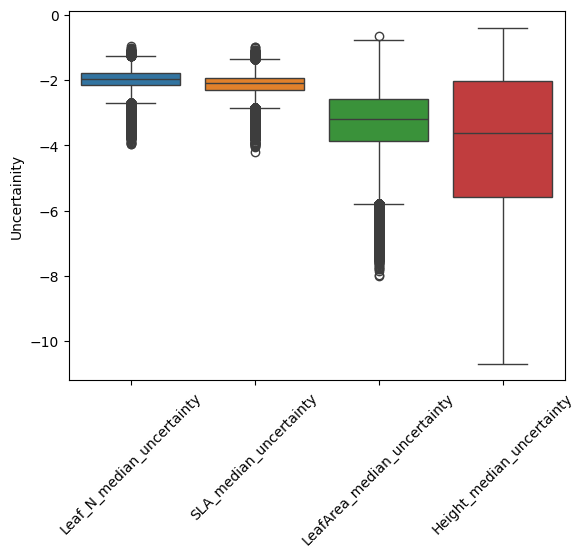

In [29]:
#plot uncertainity
import seaborn as sns
uncertainty = val[uncertainity_cols]
sns.boxplot(data=uncertainty)
plt.ylabel('Uncertainity')
#plt.yscale('log')
plt.xticks(rotation=45)

**Update path to your current training file**

In [30]:
train_meta = pd.read_csv('<path/to/train.csv>')
train_meta.shape

(284336, 100)

In [31]:
train_meta['Species'].nunique()

5287

In [32]:
subval = train_meta[['image', 'Species', 'pft']]


In [33]:
val = pd.concat([val, subval], axis=1)
val

,Height_median_true,LeafArea_median_true,SLA_median_true,Leaf_N_median_true,Height_median_pred,LeafArea_median_pred,SLA_median_pred,Leaf_N_median_pred,Leaf_N_median_uncertainty,SLA_median_uncertainty,LeafArea_median_uncertainty,Height_median_uncertainty,pred,true,image,Species,pft
0,13.987935,12.463890,11.578178,24.527560,10.776169,15.471607,16.763678,27.109470,-1.585836,-2.082406,-2.341355,-1.713484,27.109470,24.527560,/mnt/ssds/as2114/panops/iNaturalist_Tree_speci...,Abarema adenophora,Tree
1,13.987935,12.463890,11.578178,24.527560,19.806814,36.857777,13.019522,20.465773,-1.674644,-2.119239,-1.906090,-1.473963,20.465773,24.527560,/mnt/ssds/as2114/panops/TRY6_gapfilled_inat_V3...,Abarema adenophora,Tree
2,13.987935,12.463890,11.578178,24.527560,15.616657,32.271458,14.150058,23.537542,-1.792509,-2.186719,-1.874176,-1.664432,23.537542,24.527560,/mnt/ssds/as2114/panops/TRY6_gapfilled_inat_V3...,Abarema adenophora,Tree
3,13.987935,12.463890,11.578178,24.527560,10.776169,15.471607,16.763678,27.109470,-1.585836,-2.082406,-2.341355,-1.713484,27.109470,24.527560,/mnt/ssds/as2114/panops/TRY6_gapfilled_inat_V3...,Abarema adenophora,Tree
4,29.822601,0.537402,7.022791,12.863557,11.991335,8.753674,9.499618,16.504852,-2.141615,-2.521720,-3.144988,-1.379227,16.504852,12.863557,/mnt/ssds/as2114/panops/iNaturalist_Vascular_P...,Abies alba,Tree
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284331,20.454890,45.830997,13.062060,23.440187,9.380766,33.747417,14.567678,23.217556,-1.769160,-2.014449,-2.327637,-1.996895,23.217556,23.440187,/mnt/ssds/as2114/panops/iNaturalist_Tree_speci...,Zuelania guidonia,Tree
284332,20.454890,45.830997,13.062060,23.440187,14.734003,47.559273,13.127729,21.790491,-1.683870,-2.031440,-1.730755,-1.422946,21.790491,23.440187,/mnt/ssds/as2114/panops/TRY6_gapfilled_inat_V3...,Zuelania guidonia,Tree
284333,20.454890,45.830997,13.062060,23.440187,16.616661,22.549948,13.077711,21.298270,-1.932134,-2.354497,-2.540022,-1.724608,21.298270,23.440187,/mnt/ssds/as2114/panops/iNaturalist_Tree_speci...,Zuelania guidonia,Tree
284334,10.619714,23.997944,16.120485,36.542060,12.624937,50.885815,14.397921,22.154661,-1.803495,-2.212242,-1.702169,-1.664809,22.154661,36.542060,/mnt/ssds/as2114/panops/iNaturalist_Tree_speci...,Zygia heteroneura,Tree


In [33]:
val.shape, train_meta.shape

((343520, 17), (343520, 99))

In [28]:
#get .95 percentile of each uncerainty
Height_uncer95 = val['Height_median_uncertainty'].quantile(0.95)
LeafArea_uncer95 = val['LeafArea_median_uncertainty'].quantile(0.95)
SLA_uncer95 = val['SLA_median_uncertainty'].quantile(0.95)
Leaf_N_uncer95 = val['Leaf_N_median_uncertainty'].quantile(0.95)

In [30]:
val_uncer_H95 = val[val['Height_median_uncertainty'] < Height_uncer95]
val_uncer_H95.shape

(326344, 17)

In [31]:
val_uncer_LA95 = val[val['LeafArea_median_uncertainty'] < LeafArea_uncer95]
val_uncer_LA95.shape

(326344, 17)

In [32]:
val_uncer_SLA95 = val[val['SLA_median_uncertainty'] < SLA_uncer95]
val_uncer_SLA95.shape

(326344, 17)

## Get intersection of all images which are highly uncertain across traits and filter them out

In [34]:
#get index where uncer < 95 percentile for all traits and filter out those index from train_meta and save
# Step 1: Calculate 95th percentiles
Height_uncer95 = val['Height_median_uncertainty'].quantile(0.95)
LeafArea_uncer95 = val['LeafArea_median_uncertainty'].quantile(0.95)
SLA_uncer95 = val['SLA_median_uncertainty'].quantile(0.95)
Leaf_N_uncer95 = val['Leaf_N_median_uncertainty'].quantile(0.95)

# Step 2: Get indices where each uncertainty is below its 95th percentile
idx_height = val[val['Height_median_uncertainty'] < Height_uncer95].index
idx_leafarea = val[val['LeafArea_median_uncertainty'] < LeafArea_uncer95].index
idx_sla = val[val['SLA_median_uncertainty'] < SLA_uncer95].index
idx_leaf_n = val[val['Leaf_N_median_uncertainty'] < Leaf_N_uncer95].index

# Step 3: Find common indices across all
common_indices = idx_height.intersection(idx_leafarea).intersection(idx_sla).intersection(idx_leaf_n)

# Step 4: Filter train_meta using these indices
train_meta_filtered = train_meta.loc[train_meta.index.intersection(common_indices)]
train_meta_filtered.shape

(284336, 99)

In [37]:
train_meta['Species'].nunique()

5503

In [35]:
train_meta_filtered['Species'].nunique()

5287

## Save updated training file

In [ ]:
#save train_meta filteres

train_meta_filtered.to_csv('./output/train_updated.csv')

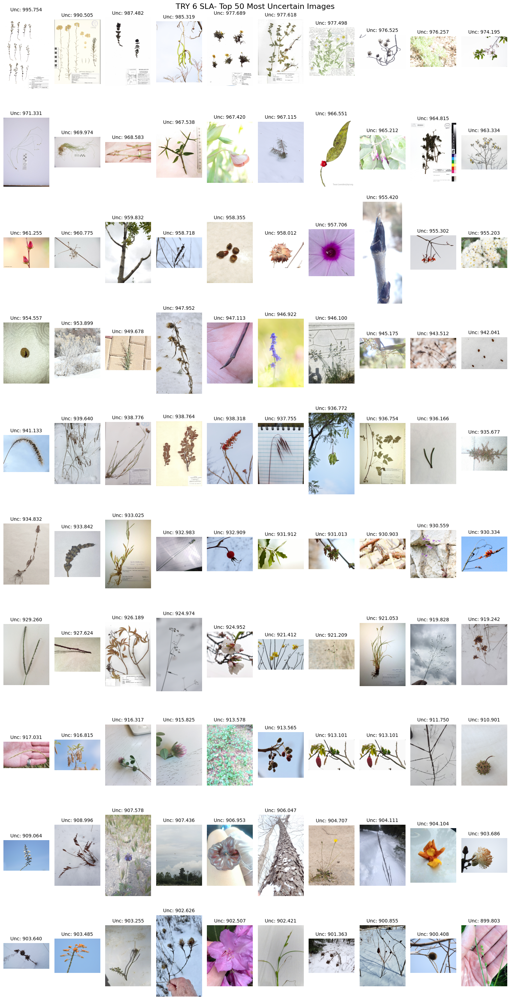

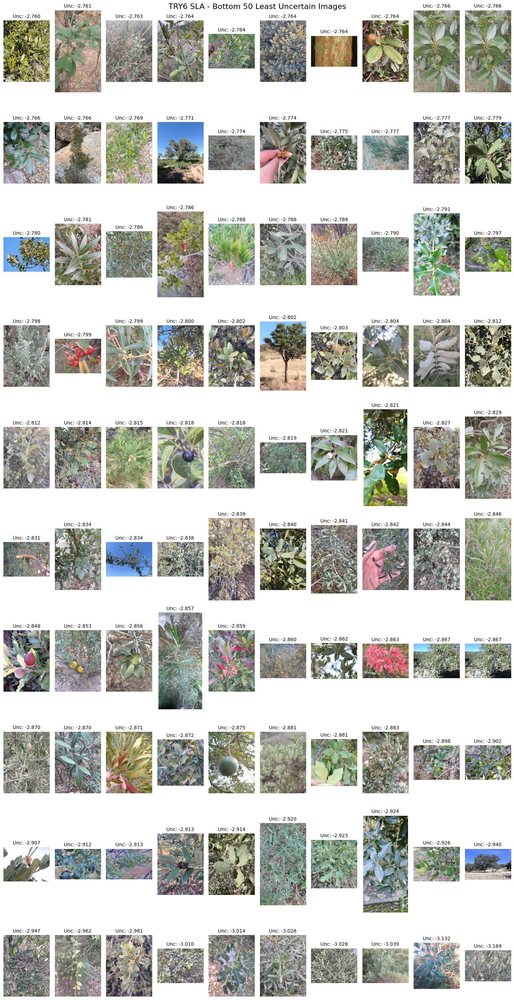

In [ ]:
#get top 50 and bottom 50 by uncertainity for SLA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Sort by Leaf_N_uncertainty (descending for most, ascending for least)
df_sorted = val.sort_values(by="SLA_uncertainty", ascending=False)

# Select top and bottom 50
top_uncertain = df_sorted.head(100)
bottom_uncertain = df_sorted.tail(100)

def plot_images(df_subset, title):
    fig, axes = plt.subplots(10, 10, figsize=(15, 30))  # 10 rows, 5 columns

    for ax, (_, row) in zip(axes.ravel(), df_subset.iterrows()):
        try:
            img = cv2.imread(row["image"])  # Load image
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert color format
            
            ax.imshow(img)
            ax.set_title(f"Unc: {row['SLA_uncertainty']:.3f}", fontsize=10)
            ax.axis("off")
        except Exception as e:
            ax.set_title("Error loading image")
            ax.axis("off")

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# Plot top 50 uncertain images
plot_images(top_uncertain, "TRY 6 SLA- Top 50 Most Uncertain Images")

# Plot bottom 50 uncertain images
plot_images(bottom_uncertain, "TRY6 SLA - Bottom 50 Least Uncertain Images")


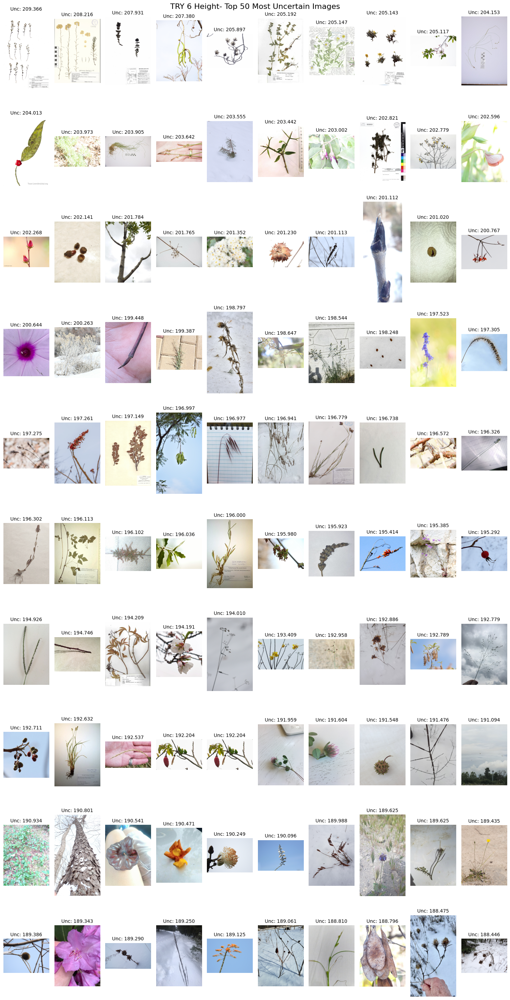

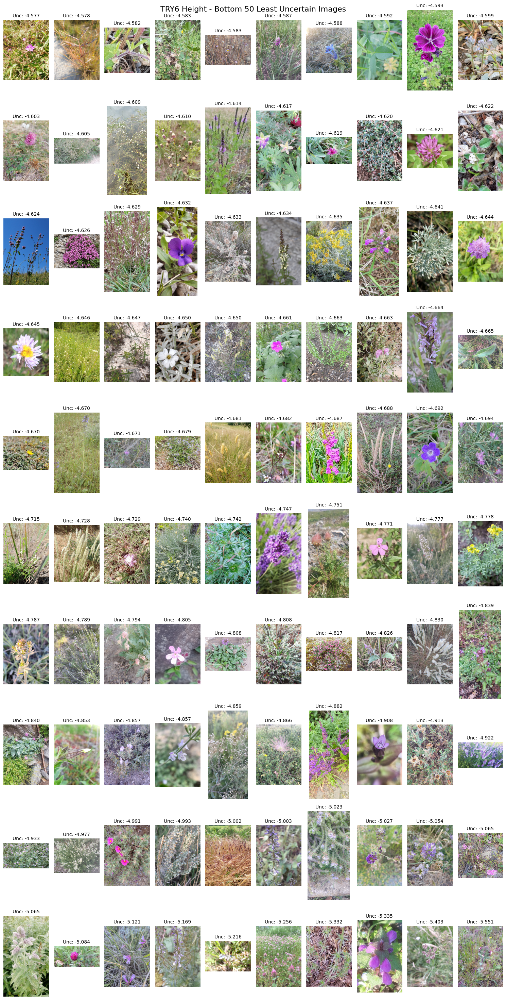

In [ ]:
#get top 50 and bottom 50 by uncertainity for Height
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Sort by Leaf_N_uncertainty (descending for most, ascending for least)
df_sorted = val.sort_values(by="Height_uncertainty", ascending=False)

# Select top and bottom 50
top_uncertain = df_sorted.head(100)
bottom_uncertain = df_sorted.tail(100)

def plot_images(df_subset, title):
    fig, axes = plt.subplots(10, 10, figsize=(15, 30))  # 10 rows, 5 columns

    for ax, (_, row) in zip(axes.ravel(), df_subset.iterrows()):
        try:
            img = cv2.imread(row["image"])  # Load image
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert color format
            
            ax.imshow(img)
            ax.set_title(f"Unc: {row['Height_uncertainty']:.3f}", fontsize=10)
            ax.axis("off")
        except Exception as e:
            ax.set_title("Error loading image")
            ax.axis("off")

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# Plot top 50 uncertain images
plot_images(top_uncertain, "TRY 6 Height- Top 50 Most Uncertain Images")

# Plot bottom 50 uncertain images
plot_images(bottom_uncertain, "TRY6 Height - Bottom 50 Least Uncertain Images")
